In [2]:
import matplotlib.pyplot as plt
import numpy as np
import skimage as sk
import skimage.io as skio
import skimage.filters
import scipy.signal
import scipy.sparse.linalg
import scipy.misc
from skimage.exposure import rescale_intensity
import glob
import math
import matplotlib._png as png
import skimage.restoration

In [3]:
def get_images_and_exposure(direc, channel,extension, initialshutter):
    direc = direc + "*" + extension
    print(direc)
    allfiles=glob.glob(direc)
    print(allfiles)
    images= []
    file_names = []
    exposures= []
    #Could use EXIF data, but, exif data is actually off compared to actual shutter speed
    #as expressed by Debevec, for example 1/500 is actually 1/512
    #first_exposure = 4
    for file in allfiles:
        print()
        if extension != ".PNG":
            image = plt.imread(file)
        else:
            image = png.read_png_int(file)
        images.append(image[:,:,channel])
        
        file_names.append(file)
        print(file)
        
        splitup = file.split(" ") 
        exposurenum = splitup[1][:-4]
        print(exposurenum)
        print(initialshutter *2 **(int(exposurenum)-1))
        exposure = 1/(initialshutter * 2 **(int(exposurenum)-1))
        print(exposure)
        exposures.append(exposure)
    return (images, exposures, file_names)

In [4]:
def get_samples(dataa, sizeofsmallimages,smoothness):
    l=smoothness
    B = np.log2(dataa[1])
    w = [z if z <= 0.5 *255 else 255-z for z in range(256)]
    smallimages = [scipy.misc.imresize(image, sizeofsmallimages,interp ='nearest') for image in dataa[0] ]
    Z = [smallimage.flatten() for smallimage in smallimages ]
    plt.imshow(smallimages[7], cmap='gray')
    plt.show()
    plt.imshow(smallimages[6], cmap='gray')
    plt.show()
    plt.imshow(smallimages[5], cmap='gray')
    plt.show()
    return (Z,B,l,w)

In [5]:
#As used in debevec paper and slides
def get_response_curve(Z,B,l,w):
    A = np.zeros( (np.size(Z,0)*np.size(Z,1)+256+1, 256+np.size(Z,1)), dtype=np.float64)
    b = np.zeros( (np.size(A,0),1), dtype=np.float64 )
    
    # Include the data−fitting equations
    k = 0
    for i in range(np.size(Z, 1)):
        for j in range(np.size(Z, 0)):
            z = Z[j][i]
            wij = w[z]
            A[k][z] = wij
            A[k][256+i] = -wij
            b[k] = wij*B[j]
            k += 1
    # Fix the curve by setting its middle value to 0
    A[k][128] = 1
    k += 1
    for i in range(256-1):
        A[k][i]= l*w[i+1]
        A[k][i+1]= -2*l*w[i+1]
        A[k][i+2]= l*w[i+1]
        k += 1
        
    x = np.linalg.lstsq(A, b)[0]
    g = x[:256]
    lE = x[256:]

    return g, lE
    

In [6]:
def get_radiance_map(images, g, ln_t,w):
    height,width = images[0].shape
    newimages=images
    #for image in images:
    #    newimages.append(image+1)
    ln_E = np.zeros((height,width))
    for y in range(height):
        for x in range(width):
            total_ln_E = 0
            total_weight = 0
            for k in range(len(newimages)):
                z = (newimages[k])[y][x]
                wt = w[z]
                gt = g[z]
                tln_t = ln_t[k]

                total_ln_E += wt  * (gt - tln_t)
                total_weight += wt 
            ln_E[y,x]= total_ln_E / total_weight if total_weight > 0 else total_ln_E
        
    return np.nan_to_num(np.exp(ln_E))

In [9]:
def tone_mapping_basic(hdr):
    disp = hdr -hdr.max() / hdr.max() - hdr.min()
    disp = disp / disp.max()
    return disp

In [10]:
def tone_mapping_reinhard(hdra):
    img = np.zeros(hdra.shape)
    height, width, channels = hdra.shape
    a=0.25
    d=0.000001
    
    luminance_map=(0.2126 * hdra[:,:,0]) + (0.7152 * hdra[:,:,1]) + (0.0722 * hdra[:,:,2])
    print(luminance_map)
    key = np.exp( (1/(height*width)) * np.log(d+luminance_map).sum() )
    
    scaled_luminance = (a/key)*luminance_map
    
    display_luminace = scaled_luminance / (1+scaled_luminance)
    
    for i in range(3):
        img[:,:,i] = (hdra[:,:,i] / luminance_map) * display_luminace
    return img

In [11]:
def tone_mapping_linear(hdr):
    img = np.zeros(hdr.shape)

    luminance_map=(0.2126 * hdr[:,:,2]) + (0.7152 * hdr[:,:,0]) + (0.0722 * hdr[:,:,1])
    print(luminance_map)
    display_luminace = luminance_map / luminance_map.max()
    
    for i in range(3):
        img[:,:,i] = (hdr[:,:,i] / luminance_map) * display_luminace
    return img

In [12]:
def tone_mapping_durand(hdr):
    img = np.zeros(hdr.shape)
    dr=6
    print(hdr.shape)
    i = (hdr[:,:,0] + hdr[:,:,0]+hdr[:,:,0])/3
    print(i)
    red = hdr[:,:,2]
    green = hdr[:,:,1]
    blue = hdr[:,:,0]
    chromred = red / i
    chromblue = blue / i
    chromgreen = green / i
    logi = np.log2(i)
    print("---------------")
    skio.imshow(logi,cmap='gray')
    skio.show()
    base = skimage.restoration.denoise_bilateral(abs(logi),multichannel=False)
    print("---------------")
    skio.imshow(base,cmap='gray')
    skio.show()
    detail = logi - base
    print("---------------")
    skio.imshow(detail,cmap='jet')
    skio.show()
    offset = base.max()
    scale = dr / (base.max() - base.min())
    modbase = (base-offset)* scale
    reci = 2**(modbase + detail)
    print("---------------")
    skio.imshow(reci *chromblue, cmap='gray')
    skio.show()
    skio.imshow(reci *chromgreen, cmap='gray')
    skio.show()
    skio.imshow(reci *chromred, cmap='gray')
    skio.show()
    img[:,:,0] = reci * chromblue
    img[:,:,1] = reci * chromgreen
    img[:,:,2] = reci * chromred
    return img**0.3

In [13]:
data_b = get_images_and_exposure("1/",0, ".JPG",4)
data_g = get_images_and_exposure("1/",1,".JPG",4)
data_r = get_images_and_exposure("1/",2,".JPG",4)

1/*.JPG
['1\\DSC_1285_ 1.JPG', '1\\DSC_1286_ 2.JPG', '1\\DSC_1287_ 3.JPG', '1\\DSC_1288_ 4.JPG', '1\\DSC_1289_ 5.JPG', '1\\DSC_1290_ 6.JPG', '1\\DSC_1291_ 7.JPG', '1\\DSC_1292_ 8.JPG']

1\DSC_1285_ 1.JPG
1
4
0.25

1\DSC_1286_ 2.JPG
2
8
0.125

1\DSC_1287_ 3.JPG
3
16
0.0625

1\DSC_1288_ 4.JPG
4
32
0.03125

1\DSC_1289_ 5.JPG
5
64
0.015625

1\DSC_1290_ 6.JPG
6
128
0.0078125

1\DSC_1291_ 7.JPG
7
256
0.00390625

1\DSC_1292_ 8.JPG
8
512
0.001953125
1/*.JPG
['1\\DSC_1285_ 1.JPG', '1\\DSC_1286_ 2.JPG', '1\\DSC_1287_ 3.JPG', '1\\DSC_1288_ 4.JPG', '1\\DSC_1289_ 5.JPG', '1\\DSC_1290_ 6.JPG', '1\\DSC_1291_ 7.JPG', '1\\DSC_1292_ 8.JPG']

1\DSC_1285_ 1.JPG
1
4
0.25

1\DSC_1286_ 2.JPG
2
8
0.125

1\DSC_1287_ 3.JPG
3
16
0.0625

1\DSC_1288_ 4.JPG
4
32
0.03125

1\DSC_1289_ 5.JPG
5
64
0.015625

1\DSC_1290_ 6.JPG
6
128
0.0078125

1\DSC_1291_ 7.JPG
7
256
0.00390625

1\DSC_1292_ 8.JPG
8
512
0.001953125
1/*.JPG
['1\\DSC_1285_ 1.JPG', '1\\DSC_1286_ 2.JPG', '1\\DSC_1287_ 3.JPG', '1\\DSC_1288_ 4.JPG', '1\\DSC_128

In [14]:
print(data_b)

([array([[214, 213, 210, ..., 239, 239, 239],
       [212, 211, 211, ..., 239, 239, 239],
       [210, 211, 212, ..., 239, 239, 239],
       ...,
       [176, 176, 176, ..., 192, 192, 192],
       [177, 177, 177, ..., 192, 192, 192],
       [178, 177, 177, ..., 192, 192, 192]], dtype=uint8), array([[150, 151, 152, ..., 180, 179, 180],
       [151, 152, 153, ..., 179, 179, 180],
       [152, 153, 153, ..., 179, 179, 180],
       ...,
       [131, 130, 130, ..., 143, 143, 143],
       [129, 129, 129, ..., 144, 144, 144],
       [128, 128, 128, ..., 145, 145, 145]], dtype=uint8), array([[118, 118, 120, ..., 130, 129, 130],
       [117, 118, 120, ..., 130, 130, 131],
       [117, 117, 119, ..., 132, 132, 133],
       ...,
       [ 94,  94,  93, ..., 103, 102, 104],
       [ 96,  96,  95, ..., 101, 100, 102],
       [ 98,  97,  96, ..., 100,  98,  99]], dtype=uint8), array([[ 89,  85,  83, ...,  98,  97,  96],
       [ 87,  84,  81, ..., 100,  99,  98],
       [ 87,  84,  82, ..., 102, 101,

In [16]:
print(data_b[1])

[0.25, 0.125, 0.0625, 0.03125, 0.015625, 0.0078125, 0.00390625, 0.001953125]


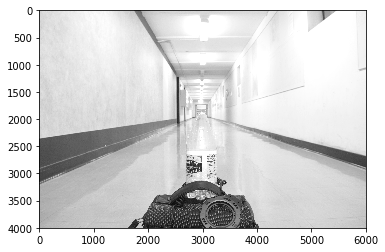

In [17]:
plt.imshow(data_b[0][0],cmap='gray')

C:\Users\1\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  """


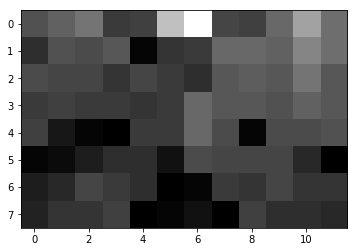

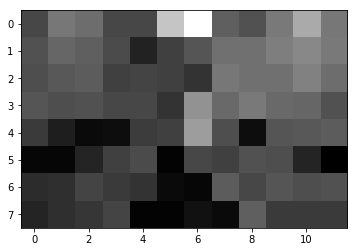

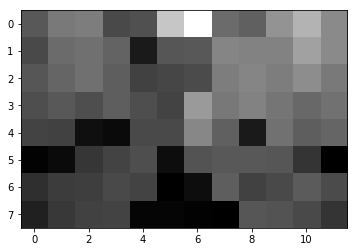

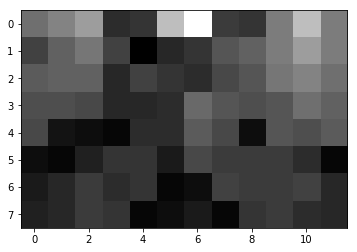

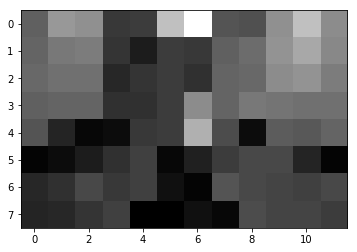

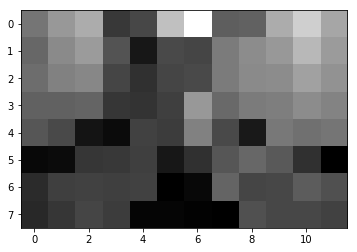

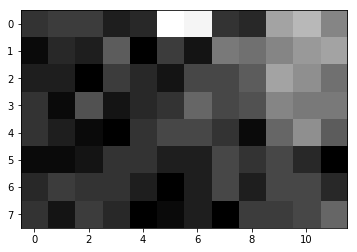

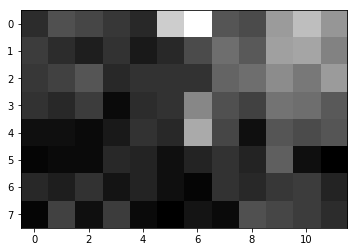

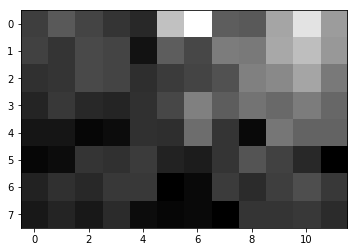

In [19]:
variables_b = get_samples(data_b,(8,12),10)
variables_g = get_samples(data_g,(8,12),10)
variables_r = get_samples(data_r,(8,12),10)

In [20]:
response_curve_b = get_response_curve(variables_b[0],variables_b[1],variables_b[2],variables_b[3])
response_curve_g = get_response_curve(variables_g[0],variables_g[1],variables_g[2],variables_g[3])
response_curve_r = get_response_curve(variables_r[0],variables_r[1],variables_r[2],variables_r[3])

C:\Users\1\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


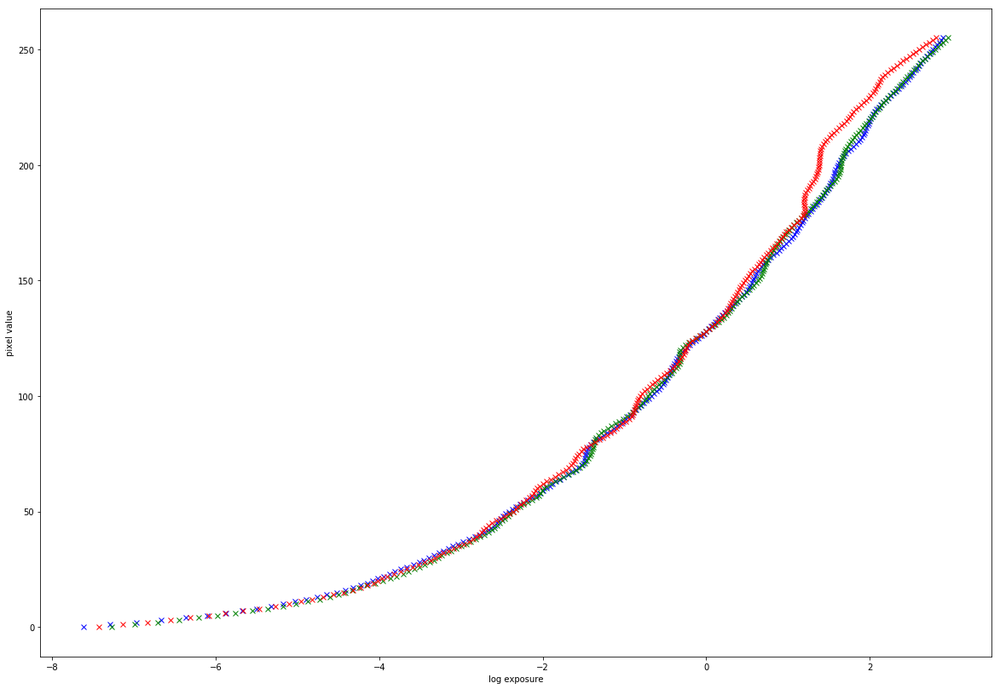

In [33]:
plt.figure(figsize=(20,14))
plt.plot(response_curve_b[0], range(256),'bx')
plt.plot(response_curve_g[0], range(256),'gx')
plt.plot(response_curve_r[0], range(256),'rx')
plt.ylabel("pixel value")
plt.xlabel("log exposure")
plt.axis("on")
plt.savefig('response_curve1.jpg')
plt.show()

In [40]:
ln_E_b = get_radiance_map(data_b[0],response_curve_b[0],variables_b[1],variables_b[3])

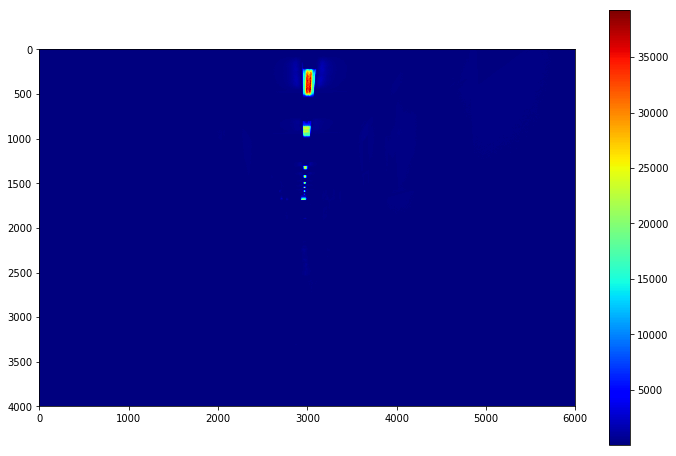

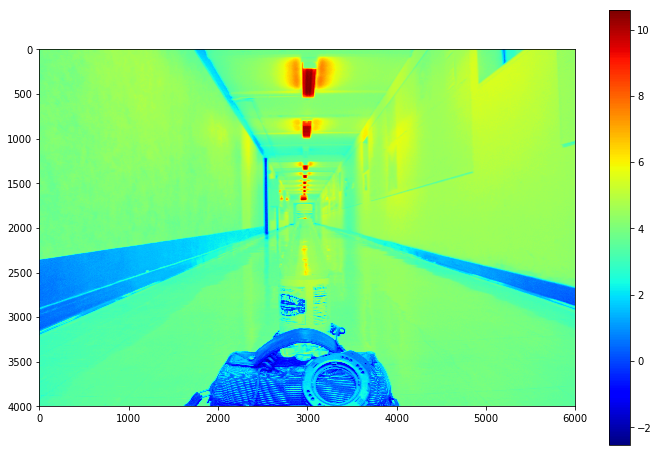

In [71]:
plt.figure(figsize=(12,8))
plt.imshow(ln_E_b,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_b),cmap='jet')
plt.colorbar()
plt.show()

In [42]:
ln_E_g = get_radiance_map(data_g[0],response_curve_g[0],variables_g[1],variables_g[3])

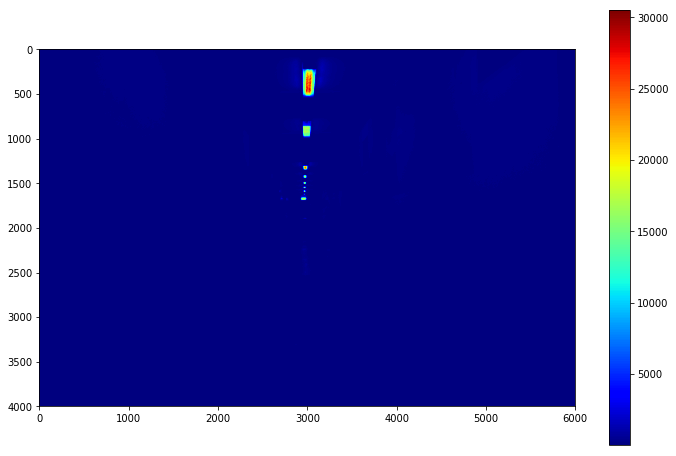

In [66]:
plt.figure(figsize=(12,8))
plt.imshow(ln_E_g,cmap='jet')
plt.colorbar()
plt.show()

In [44]:
ln_E_r = get_radiance_map(data_r[0],response_curve_r[0],variables_r[1],variables_r[3])

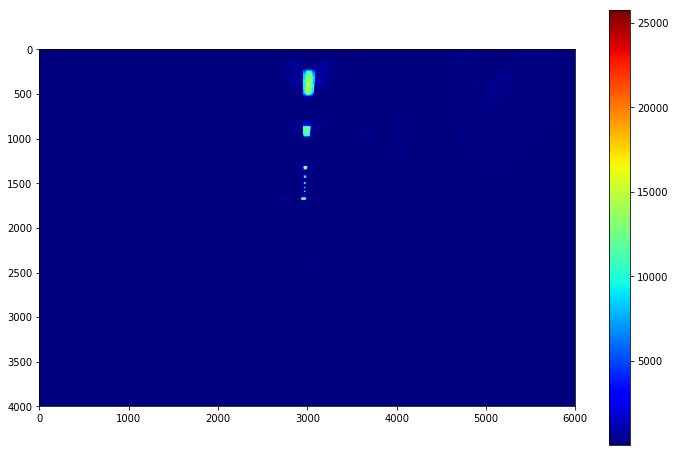

In [67]:
plt.figure(figsize=(12,8))
plt.imshow(ln_E_r,cmap='jet')
plt.colorbar()
plt.show()

In [91]:
imheight,imwidth = data_b[0][0].shape
hdr = np.zeros((imheight,imwidth,3) , 'float64')
print(hdr.shape)

(4000, 6000, 3)


In [92]:
hdr[...,0]=ln_E_b
hdr[...,1]=ln_E_g
hdr[...,2]=ln_E_r

(4000, 6000, 3)
[[46.46279881 45.6474887  45.68193305 ... 71.4671769  70.63489867
  71.44085375]
 [45.56248048 45.30170091 45.42153002 ... 72.3211967  72.21124583
  72.32966829]
 [45.84350185 45.64612973 45.7674847  ... 75.37773364 74.40120022
  74.39483422]
 ...
 [23.74663014 23.37392157 23.46296453 ... 33.02245253 32.40217543
  32.9065982 ]
 [23.89062435 23.8932895  23.99568784 ... 32.73401107 32.13832145
  32.35429302]
 [24.32406016 24.18499728 24.08502564 ... 32.89432274 32.26375891
  32.22615841]]
---------------


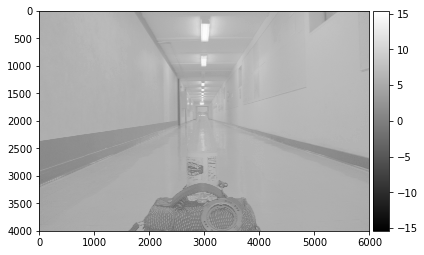

---------------


C:\Users\1\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:80: UserWarning: Float image out of standard range; displaying image with stretched contrast.
  warn("Float image out of standard range; displaying "


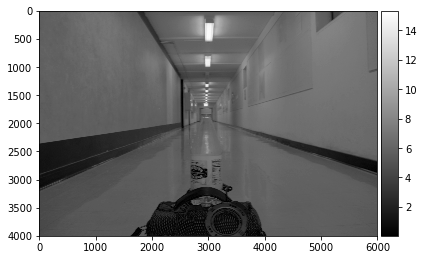

---------------


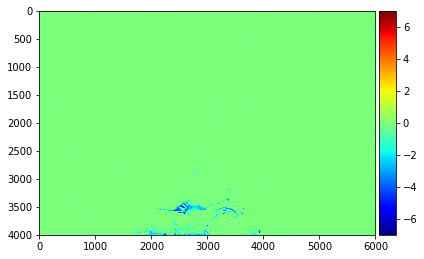

---------------


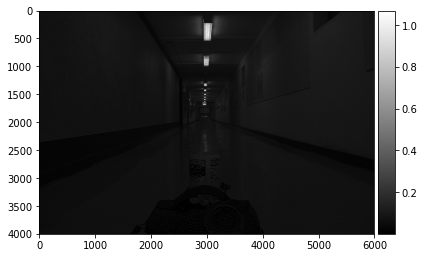

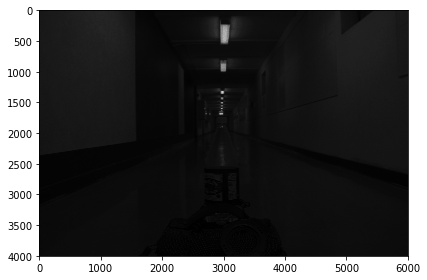

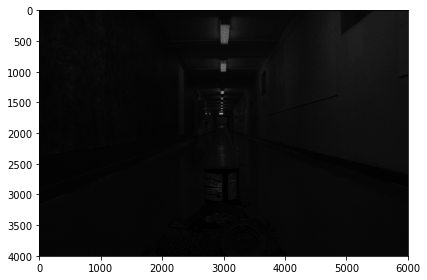

In [93]:
tonemapped = tone_mapping_durand(hdr)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


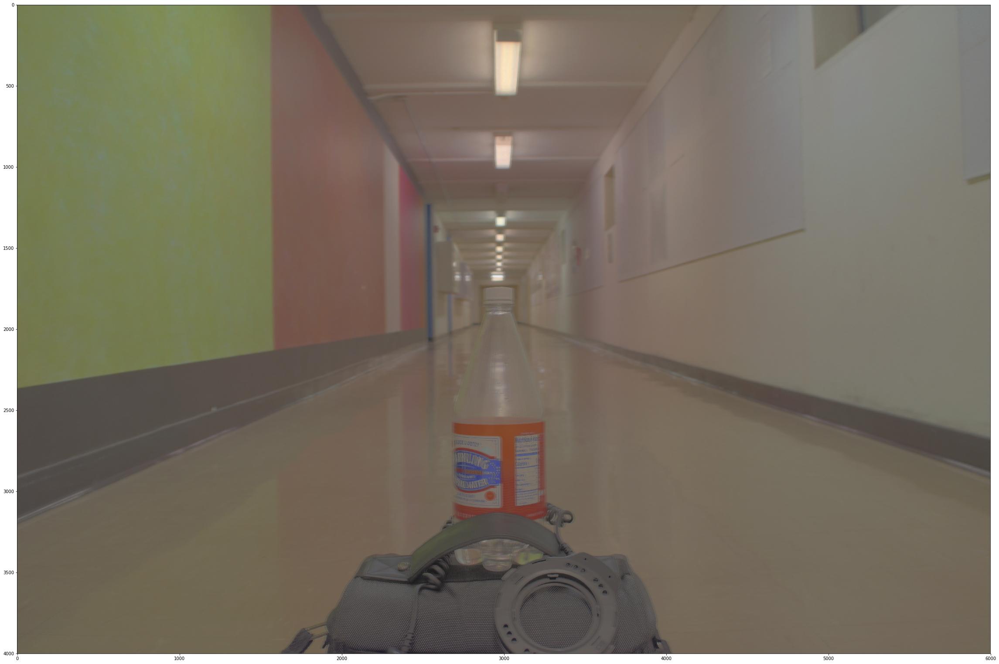

In [94]:
plt.figure(figsize=(40,60))
plt.imshow(tonemapped)
plt.show()

In [95]:
tonemapped12 = tone_mapping_basic(np.log(hdr))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


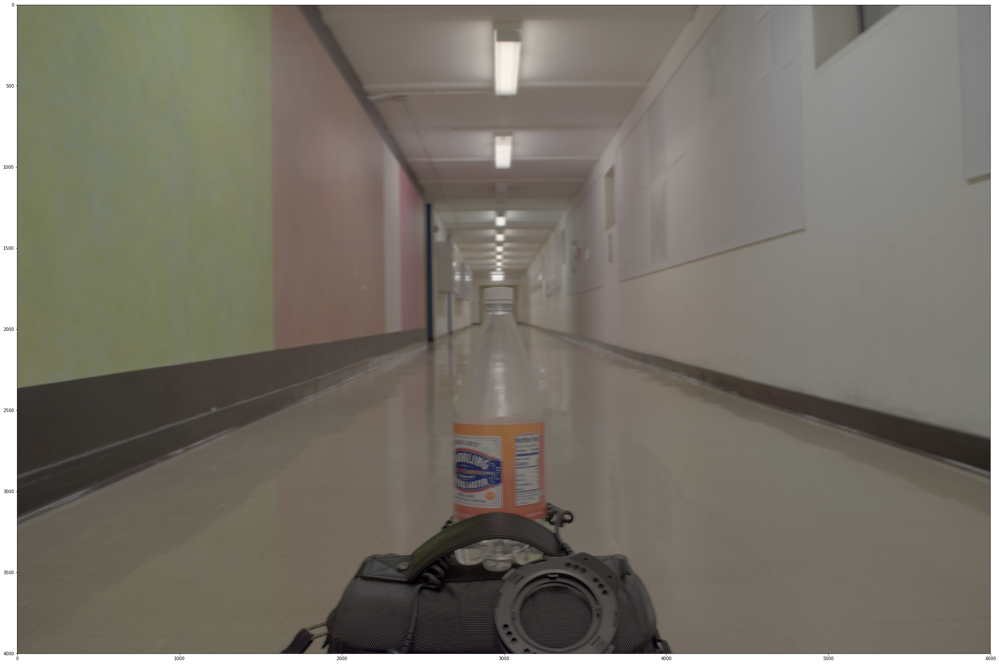

In [96]:
plt.figure(figsize=(40,60))
plt.imshow(tonemapped12)
plt.show()

In [28]:
data_b2 = get_images_and_exposure("3/",0,".PNG",0.03125)
data_g2 = get_images_and_exposure("3/",1,".PNG",0.03125)
data_r2 = get_images_and_exposure("3/",2,".PNG",0.03125)

3/*.PNG
['3\\memorial0061_ 1.png', '3\\memorial0062_ 2.png', '3\\memorial0063_ 3.png', '3\\memorial0064_ 4.png', '3\\memorial0065_ 5.png', '3\\memorial0066_ 6.png', '3\\memorial0067_ 7.png', '3\\memorial0068_ 8.png', '3\\memorial0069_ 9.png', '3\\memorial0070_ 10.png', '3\\memorial0071_ 11.png', '3\\memorial0072_ 12.png', '3\\memorial0073_ 13.png', '3\\memorial0074_ 14.png', '3\\memorial0075_ 15.png', '3\\memorial0076_ 16.png']

3\memorial0061_ 1.png
1
0.03125
32.0

3\memorial0062_ 2.png
2
0.0625
16.0

3\memorial0063_ 3.png
3
0.125
8.0

3\memorial0064_ 4.png
4
0.25
4.0

3\memorial0065_ 5.png
5
0.5
2.0

3\memorial0066_ 6.png
6
1.0
1.0

3\memorial0067_ 7.png
7
2.0
0.5

3\memorial0068_ 8.png
8
4.0
0.25

3\memorial0069_ 9.png
9
8.0
0.125

3\memorial0070_ 10.png
10
16.0
0.0625

3\memorial0071_ 11.png
11
32.0
0.03125

3\memorial0072_ 12.png
12
64.0
0.015625

3\memorial0073_ 13.png
13
128.0
0.0078125

3\memorial0074_ 14.png
14
256.0
0.00390625

3\memorial0075_ 15.png
15
512.0
0.001953125

3\m

([array([[  0, 108, 134, ..., 215, 214, 238],
       [  0, 126, 150, ..., 228, 252, 246],
       [  0, 155, 129, ..., 199, 224, 232],
       ...,
       [  0, 142, 142, ..., 255, 255, 255],
       [  0, 142, 144, ..., 255, 255, 255],
       [  0, 141, 143, ...,   0,   0,   0]], dtype=uint8), array([[  0,   0,  98, ..., 178, 199, 188],
       [  0,   0, 108, ..., 150, 178, 180],
       [  0,   0,  81, ..., 174, 160, 192],
       ...,
       [  0,   0,   0, ..., 235, 229, 232],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0]], dtype=uint8), array([[  0,   0,   0, ..., 112, 134,   0],
       [ 54,  66,  69, ..., 107, 116,   0],
       [ 66,  66,  54, ..., 135, 117,   0],
       ...,
       [ 63,  66,  66, ..., 181, 170,   0],
       [ 64,  64,  66, ..., 178, 176,   0],
       [ 65,  65,  66, ..., 176, 173,   0]], dtype=uint8), array([[  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,   0],
       [  0,   0,   0, ...,   0,   0,

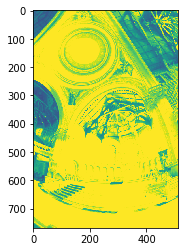

In [29]:
plt.imshow(data_b2[0][0])
print(data_b2)

C:\Users\1\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  """


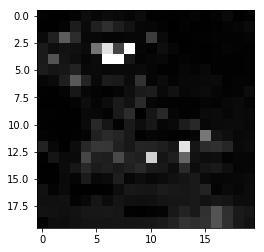

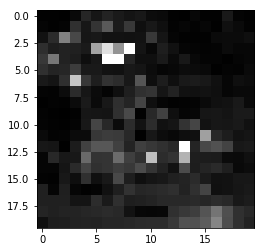

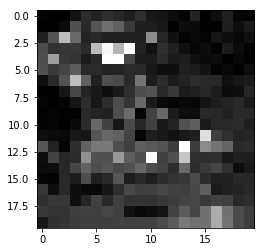

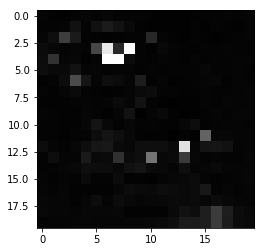

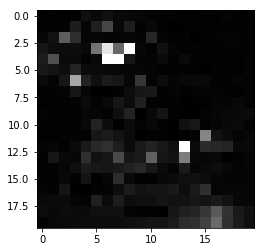

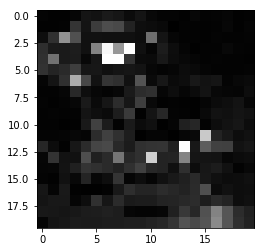

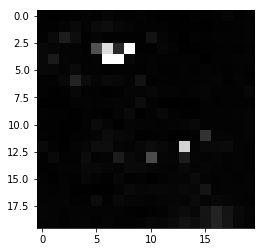

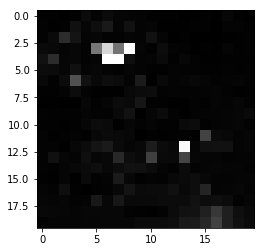

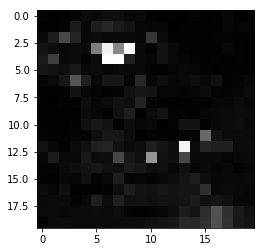

In [30]:
variables_b2 = get_samples(data_b2,(20,20),20)
variables_g2 = get_samples(data_g2,(20,20),20)
variables_r2 = get_samples(data_r2,(20,20),20)

In [31]:
response_curve_b2 = get_response_curve(variables_b2[0],variables_b2[1],variables_b2[2],variables_b2[3])
response_curve_g2 = get_response_curve(variables_g2[0],variables_g2[1],variables_g2[2],variables_g2[3])
response_curve_r2 = get_response_curve(variables_r2[0],variables_r2[1],variables_r2[2],variables_r2[3])

C:\Users\1\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


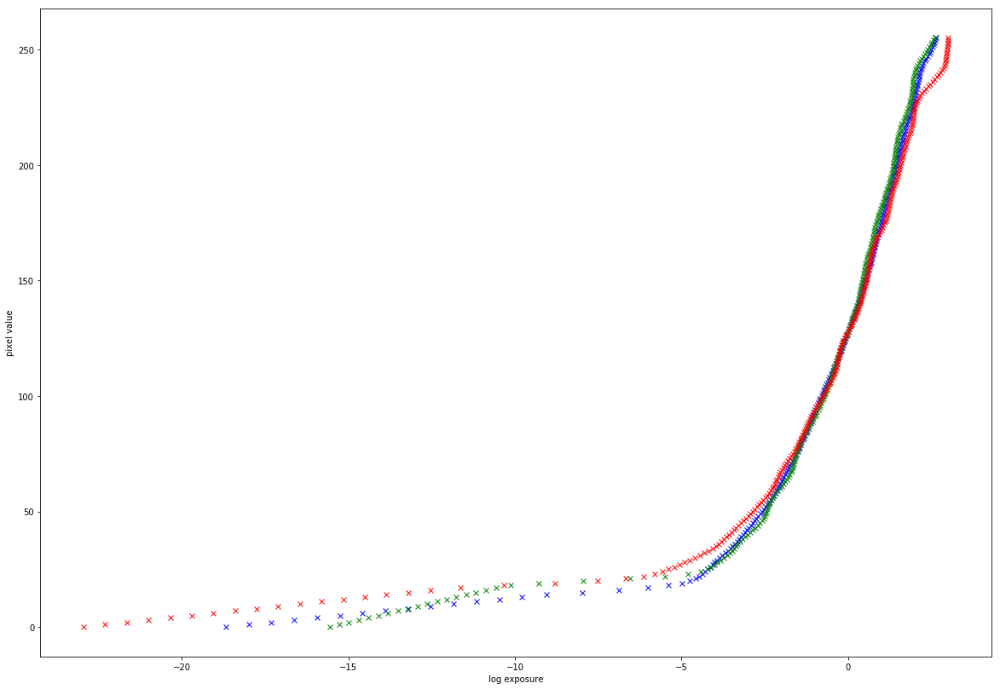

In [34]:
plt.figure(figsize=(20,14))
plt.plot(response_curve_b2[0], range(256),'bx')
plt.plot(response_curve_g2[0], range(256),'gx')
plt.plot(response_curve_r2[0], range(256),'rx')
plt.ylabel("pixel value")
plt.xlabel("log exposure")
plt.axis("on")
plt.savefig('response_curve2.jpg')
plt.show()

In [46]:
ln_E_b2 = get_radiance_map(data_b2[0],response_curve_b2[0],variables_b2[1],variables_b2[3])
ln_E_g2 = get_radiance_map(data_g2[0],response_curve_g2[0],variables_g2[1],variables_g2[3])
ln_E_r2 = get_radiance_map(data_r2[0],response_curve_r2[0],variables_r2[1],variables_r2[3])

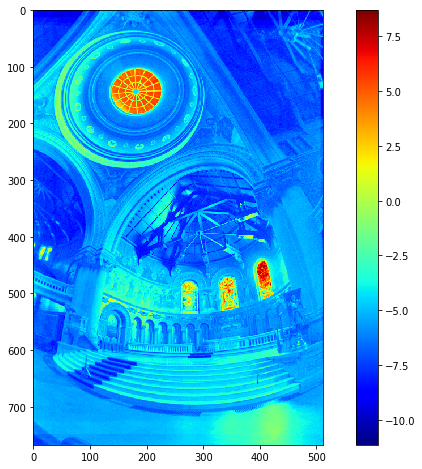

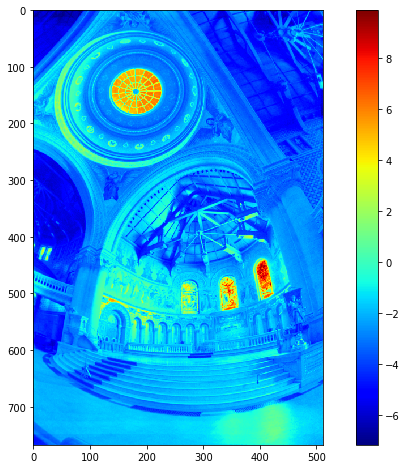

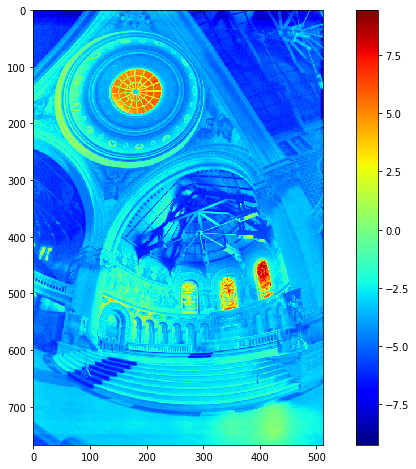

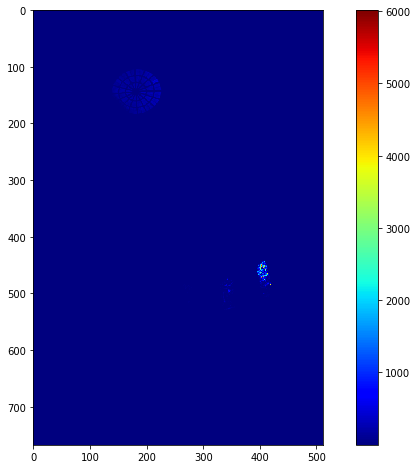

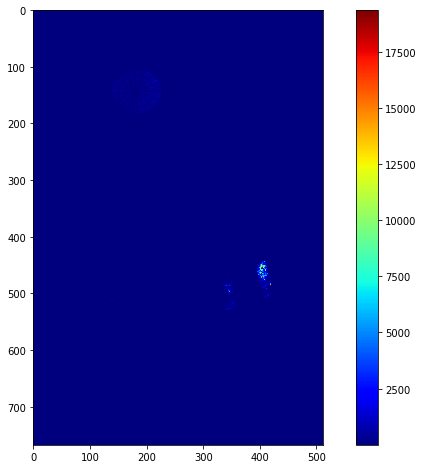

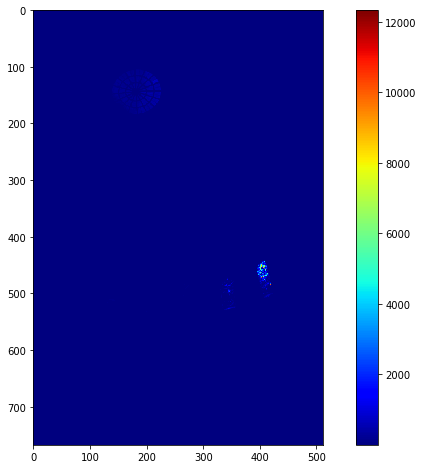

In [47]:
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_r2),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_b2),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_g2),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_r2,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_b2,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_g2,cmap='jet')
plt.colorbar()
plt.show()

In [48]:
imheight2,imwidth2 = data_b2[0][0].shape
hdr2 = np.zeros((imheight2,imwidth2,3) , 'float64')
hdr2[...,0]=ln_E_b2
hdr2[...,1]=ln_E_g2
hdr2[...,2]=ln_E_r2
tonemapped2 = tone_mapping_basic(np.log(hdr2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


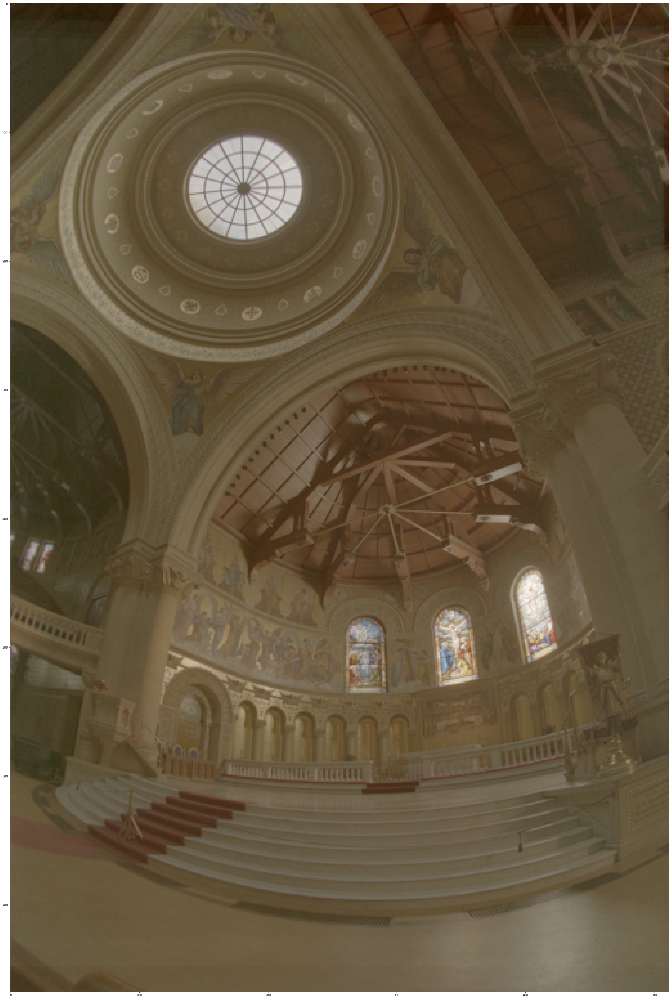

In [49]:
plt.figure(figsize=(40,60))
plt.imshow(tonemapped2)
plt.show()

In [50]:
imheight22,imwidth22 = data_b2[0][0].shape
hdr22 = np.zeros((imheight22,imwidth22,3) , 'float64')
hdr22[...,0]=ln_E_b2
hdr22[...,1]=ln_E_g2
hdr22[...,2]=ln_E_r2
tonemapped22 = tone_mapping_linear(hdr22)

[[0.00128547 0.0026901  0.00435389 ... 0.02780139 0.0405859  0.04448619]
 [0.00259344 0.00439854 0.00589337 ... 0.0214673  0.03046606 0.03714182]
 [0.00523442 0.00573345 0.00357509 ... 0.03289286 0.02788292 0.04208713]
 ...
 [0.00942141 0.00797796 0.00844659 ... 0.10520068 0.08900631 0.11540645]
 [0.01016195 0.00813758 0.00890518 ... 0.09371312 0.09867683 0.09783129]
 [0.01363813 0.01015866 0.00938537 ... 0.08901196 0.09074181 0.09685213]]


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


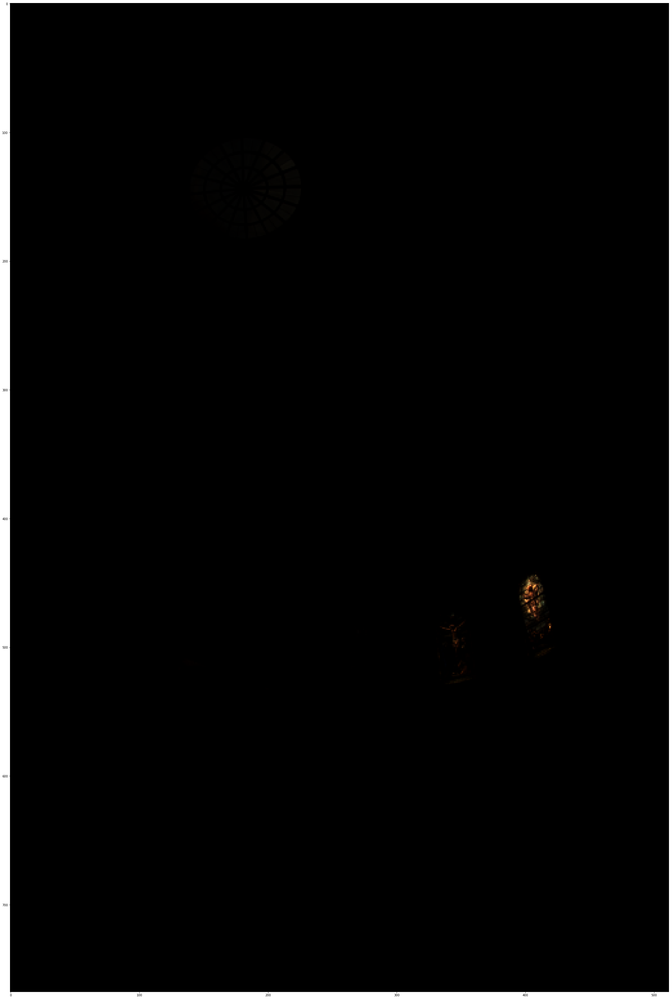

In [51]:
plt.figure(figsize=(40,60))
plt.imshow(tonemapped22)
plt.show()

(768, 512, 3)
[[0.00178319 0.0036484  0.0058957  ... 0.0372031  0.05408935 0.05971147]
 [0.00356491 0.00595181 0.00791325 ... 0.02876236 0.04033225 0.0498067 ]
 [0.00717762 0.0076902  0.00475652 ... 0.0445735  0.03758009 0.05630387]
 ...
 [0.01224074 0.01052433 0.01114591 ... 0.13723964 0.11607727 0.15077852]
 [0.01306186 0.01075924 0.01182177 ... 0.12140533 0.12846881 0.12583672]
 [0.0172282  0.01338969 0.01251483 ... 0.11442422 0.11528013 0.12256894]]
---------------


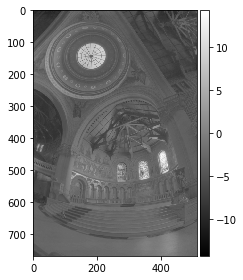

---------------


C:\Users\1\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:80: UserWarning: Float image out of standard range; displaying image with stretched contrast.
  warn("Float image out of standard range; displaying "


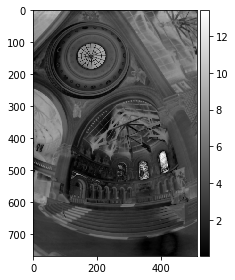

---------------


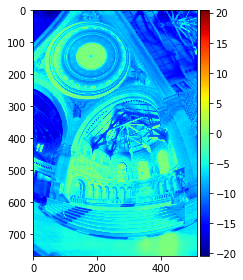

---------------


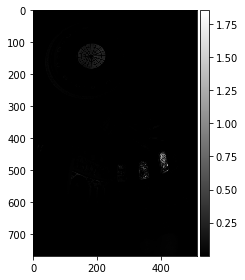

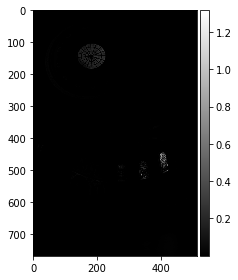

C:\Users\1\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:77: UserWarning: Low image data range; displaying image with stretched contrast.
  warn("Low image data range; displaying image with "


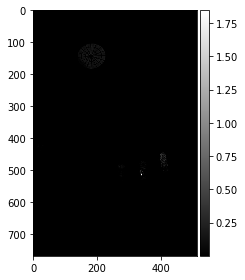

In [52]:
imheight23,imwidth23 = data_b2[0][0].shape
hdr23 = np.zeros((imheight23,imwidth23,3) , 'float64')
#print(ln_E_b2)
#print(ln_E_g2)
#print(ln_E_r2)
hdr23[...,0]=ln_E_b2
hdr23[...,1]=ln_E_g2
hdr23[...,2]=ln_E_r2
#print("----------")
#print(np.log(ln_E_b2))
#print("----------")
#print(np.log(ln_E_g2))
#print("----------")
#print(np.log(ln_E_r2))
tonemapped23 = tone_mapping_durand(hdr23)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


[[[0.0164899  0.00689991 0.00389292]
  [0.0216454  0.0132181  0.00814786]
  [0.02615801 0.01676825 0.00934857]
  ...
  [0.06323281 0.0453281  0.02388658]
  [0.07334124 0.05277176 0.0302035 ]
  [0.07929379 0.05519667 0.02990101]]

 [[0.02148847 0.01025941 0.0074237 ]
  [0.02581164 0.01617146 0.00987143]
  [0.02846736 0.01919011 0.01143086]
  ...
  [0.05822361 0.04095719 0.02240876]
  [0.06531436 0.04965752 0.02702157]
  [0.07199502 0.05094245 0.02663365]]

 [[0.02754333 0.01305879 0.01032256]
  [0.02801094 0.01898934 0.01139081]
  [0.02360922 0.01685122 0.01019914]
  ...
  [0.06810501 0.04212909 0.02563366]
  [0.06423293 0.04255531 0.02441476]
  [0.07431861 0.05367552 0.02767206]]

 ...

 [[0.03658354 0.03115508 0.0155241 ]
  [0.03467769 0.02713467 0.01425242]
  [0.03518422 0.02698528 0.01514493]
  ...
  [0.112594   0.08805949 0.05500719]
  [0.10750385 0.08277847 0.05396518]
  [0.12178951 0.09669822 0.05681629]]

 [[0.03787775 0.03234017 0.01868242]
  [0.03534838 0.02622732 0.01577363]


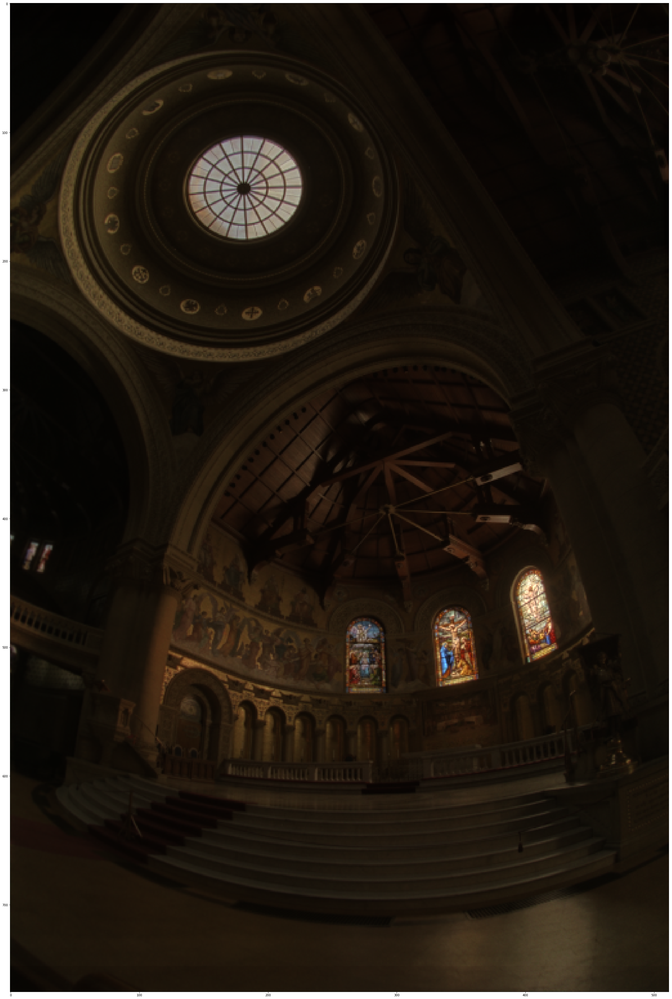

In [53]:
plt.figure(figsize=(40,60))
print(tonemapped23)
plt.imshow(tonemapped23)
plt.show()

In [54]:
data_b3 = get_images_and_exposure("2/",0,".JPG",4)
data_g3 = get_images_and_exposure("2/",1,".JPG",4)
data_r3 = get_images_and_exposure("2/",2,".JPG",4)

2/*.JPG
['2\\DSC_1293_ 1.JPG', '2\\DSC_1294_ 2.JPG', '2\\DSC_1295_ 3.JPG', '2\\DSC_1296_ 4.JPG', '2\\DSC_1297_ 5.JPG', '2\\DSC_1298_ 6.JPG', '2\\DSC_1299_ 7.JPG', '2\\DSC_1300_ 8.JPG', '2\\DSC_1301_ 9.JPG']

2\DSC_1293_ 1.JPG
1
4
0.25

2\DSC_1294_ 2.JPG
2
8
0.125

2\DSC_1295_ 3.JPG
3
16
0.0625

2\DSC_1296_ 4.JPG
4
32
0.03125

2\DSC_1297_ 5.JPG
5
64
0.015625

2\DSC_1298_ 6.JPG
6
128
0.0078125

2\DSC_1299_ 7.JPG
7
256
0.00390625

2\DSC_1300_ 8.JPG
8
512
0.001953125

2\DSC_1301_ 9.JPG
9
1024
0.0009765625
2/*.JPG
['2\\DSC_1293_ 1.JPG', '2\\DSC_1294_ 2.JPG', '2\\DSC_1295_ 3.JPG', '2\\DSC_1296_ 4.JPG', '2\\DSC_1297_ 5.JPG', '2\\DSC_1298_ 6.JPG', '2\\DSC_1299_ 7.JPG', '2\\DSC_1300_ 8.JPG', '2\\DSC_1301_ 9.JPG']

2\DSC_1293_ 1.JPG
1
4
0.25

2\DSC_1294_ 2.JPG
2
8
0.125

2\DSC_1295_ 3.JPG
3
16
0.0625

2\DSC_1296_ 4.JPG
4
32
0.03125

2\DSC_1297_ 5.JPG
5
64
0.015625

2\DSC_1298_ 6.JPG
6
128
0.0078125

2\DSC_1299_ 7.JPG
7
256
0.00390625

2\DSC_1300_ 8.JPG
8
512
0.001953125

2\DSC_1301_ 9.JPG
9
1024

([array([[168, 165, 162, ..., 196, 196, 196],
       [168, 166, 164, ..., 196, 196, 196],
       [168, 166, 165, ..., 196, 196, 196],
       ...,
       [153, 152, 151, ...,  44,  45,  47],
       [150, 149, 148, ...,  45,  47,  49],
       [142, 142, 143, ...,  46,  48,  51]], dtype=uint8), array([[126, 127, 127, ..., 147, 148, 147],
       [125, 126, 126, ..., 147, 147, 147],
       [124, 124, 125, ..., 146, 146, 146],
       ...,
       [103, 106, 112, ...,  27,  28,  28],
       [104, 110, 118, ...,  28,  29,  30],
       [104, 113, 122, ...,  29,  30,  31]], dtype=uint8), array([[ 94,  92,  90, ..., 110, 110, 111],
       [ 93,  92,  90, ..., 110, 110, 111],
       [ 93,  91,  90, ..., 110, 110, 111],
       ...,
       [ 74,  74,  76, ...,  19,  19,  18],
       [ 74,  74,  75, ...,  19,  19,  18],
       [ 74,  73,  74, ...,  18,  17,  17]], dtype=uint8), array([[48, 49, 49, ..., 71, 71, 71],
       [51, 51, 52, ..., 75, 75, 76],
       [53, 53, 53, ..., 76, 77, 77],
       ...,

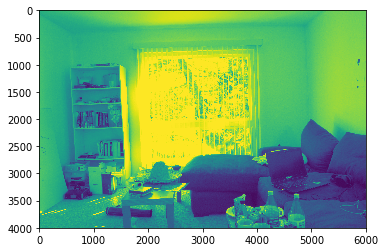

In [55]:
plt.imshow(data_b3[0][0])
print(data_b3)

C:\Users\1\Anaconda3\lib\site-packages\ipykernel_launcher.py:5: DeprecationWarning: `imresize` is deprecated!
`imresize` is deprecated in SciPy 1.0.0, and will be removed in 1.2.0.
Use ``skimage.transform.resize`` instead.
  """


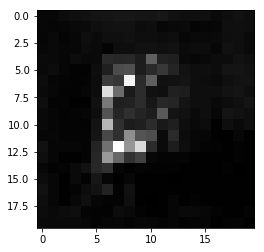

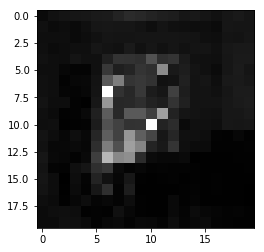

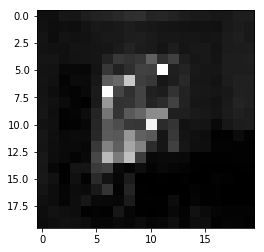

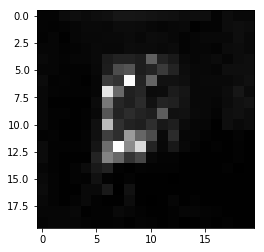

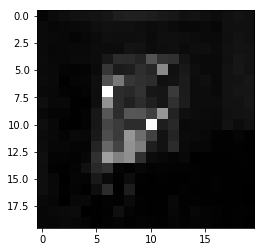

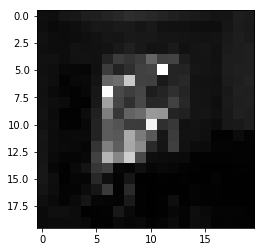

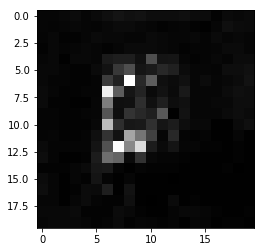

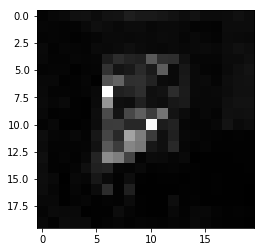

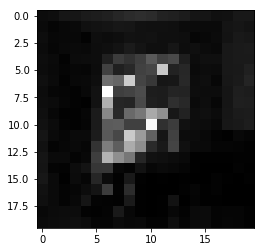

In [56]:
variables_b3 = get_samples(data_b3,(20,20),20)
variables_g3 = get_samples(data_g3,(20,20),20)
variables_r3 = get_samples(data_r3,(20,20),20)

In [57]:
response_curve_b3 = get_response_curve(variables_b3[0],variables_b3[1],variables_b3[2],variables_b3[3])
response_curve_g3 = get_response_curve(variables_g3[0],variables_g3[1],variables_g3[2],variables_g3[3])
response_curve_r3 = get_response_curve(variables_r3[0],variables_r3[1],variables_r3[2],variables_r3[3])

C:\Users\1\Anaconda3\lib\site-packages\ipykernel_launcher.py:25: FutureWarning: `rcond` parameter will change to the default of machine precision times ``max(M, N)`` where M and N are the input matrix dimensions.
To use the future default and silence this warning we advise to pass `rcond=None`, to keep using the old, explicitly pass `rcond=-1`.


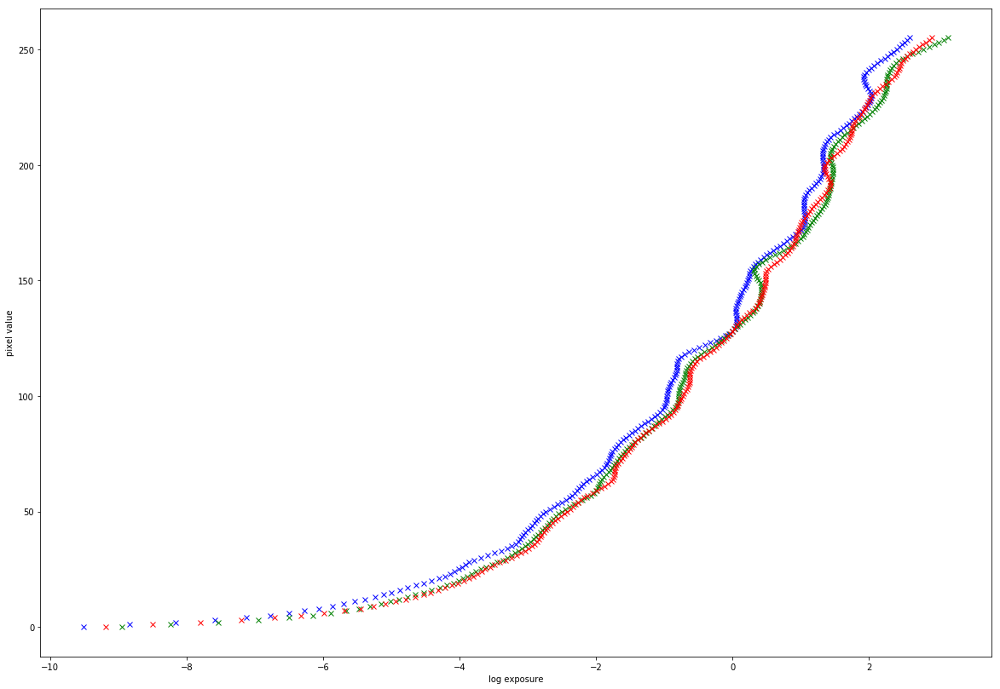

In [58]:
plt.figure(figsize=(20,14))
plt.plot(response_curve_b3[0], range(256),'bx')
plt.plot(response_curve_g3[0], range(256),'gx')
plt.plot(response_curve_r3[0], range(256),'rx')
plt.ylabel("pixel value")
plt.xlabel("log exposure")
plt.axis("on")
plt.savefig('response_curve3.jpg')
plt.show()

In [59]:
ln_E_b3 = get_radiance_map(data_b3[0],response_curve_b3[0],variables_b3[1],variables_b3[3])
ln_E_g3 = get_radiance_map(data_g3[0],response_curve_g3[0],variables_g3[1],variables_g3[3])
ln_E_r3 = get_radiance_map(data_r3[0],response_curve_r3[0],variables_r3[1],variables_r3[3])

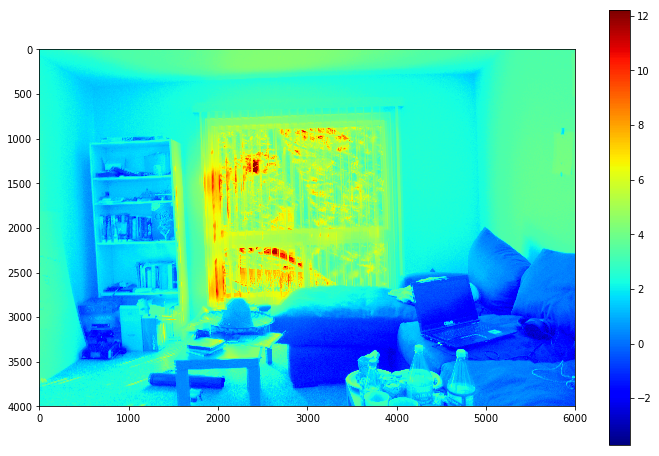

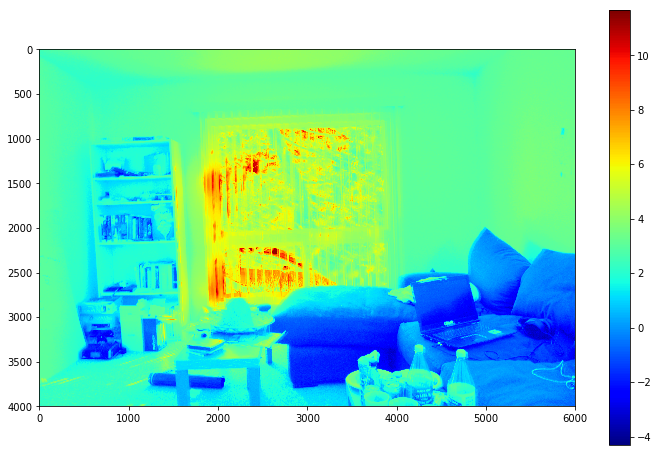

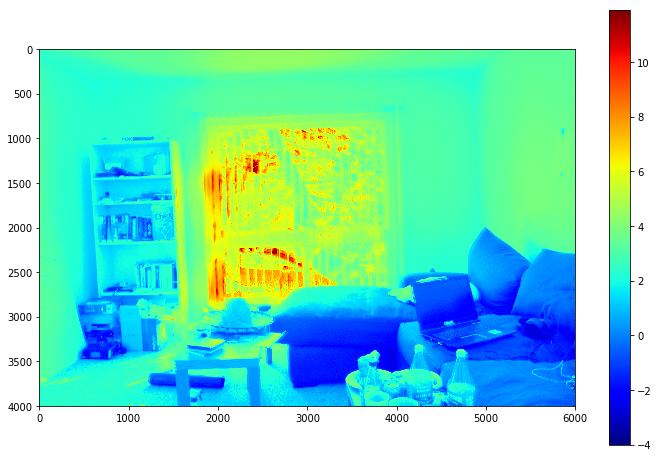

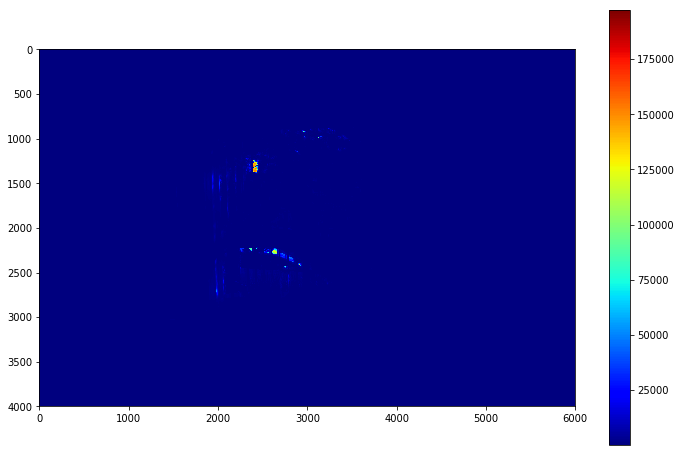

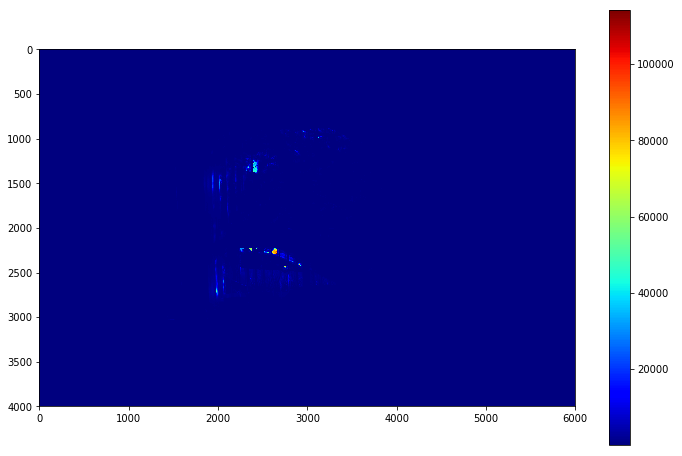

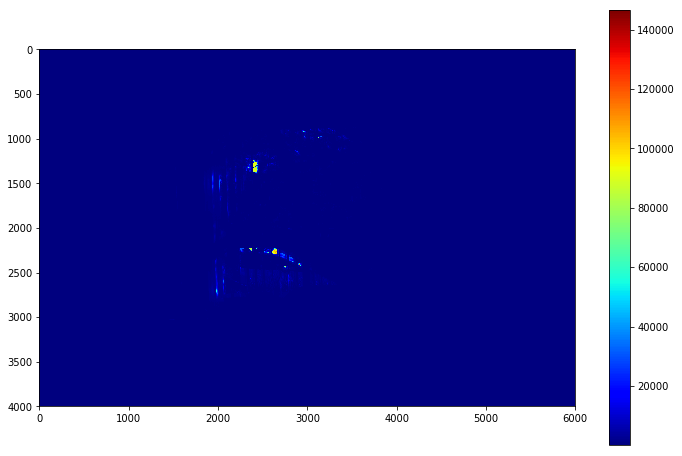

In [60]:
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_r3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_b3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_g3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_r3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_b3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_g3,cmap='jet')
plt.colorbar()
plt.show()

(4000, 6000, 3)
[[15.90957208 15.5366263  14.86742559 ... 25.245777   24.89833556
  24.36052374]
 [15.83365371 15.7235623  15.20669913 ... 25.17675838 24.70899401
  24.62760393]
 [15.81080085 15.1296661  15.14091596 ... 24.86261966 24.78749354
  24.60438631]
 ...
 [ 8.74275283  8.91767967  9.41784191 ...  0.46795157  0.48367879
   0.48348046]
 [ 8.79330063  9.08452071  9.59628703 ...  0.48566031  0.508501
   0.52424381]
 [ 8.38128152  8.6717314  10.03915819 ...  0.48893774  0.51495825
   0.55905429]]
---------------


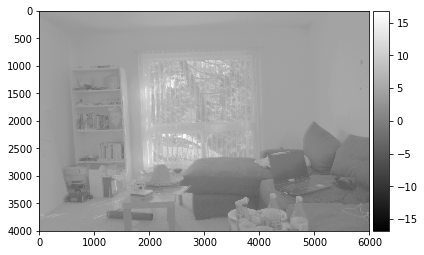

---------------


C:\Users\1\Anaconda3\lib\site-packages\skimage\io\_plugins\matplotlib_plugin.py:80: UserWarning: Float image out of standard range; displaying image with stretched contrast.
  warn("Float image out of standard range; displaying "


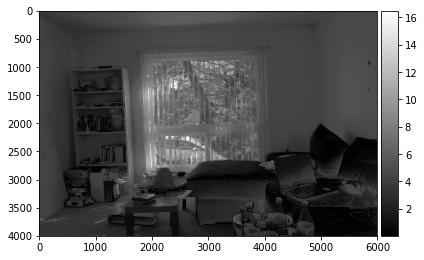

---------------


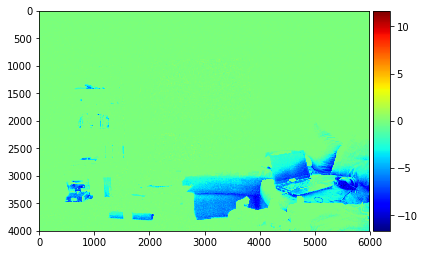

---------------


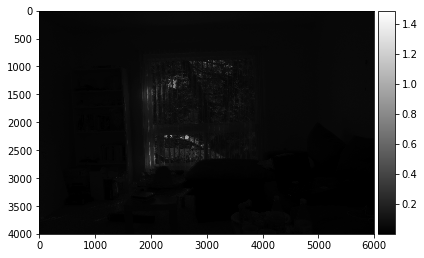

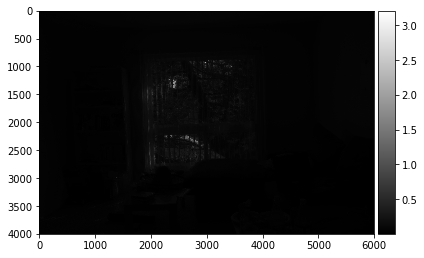

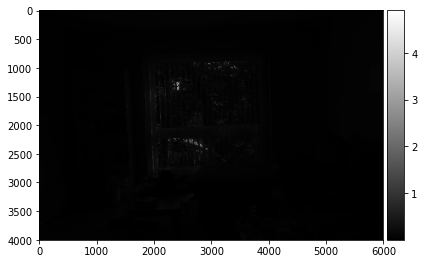

In [61]:
imheight3,imwidth3 = data_b3[0][0].shape
hdr3 = np.zeros((imheight3,imwidth3,3) , 'float64')
hdr3[...,0]=ln_E_b3
hdr3[...,1]=ln_E_g3
hdr3[...,2]=ln_E_r3
tonemapped3 = tone_mapping_durand(hdr3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


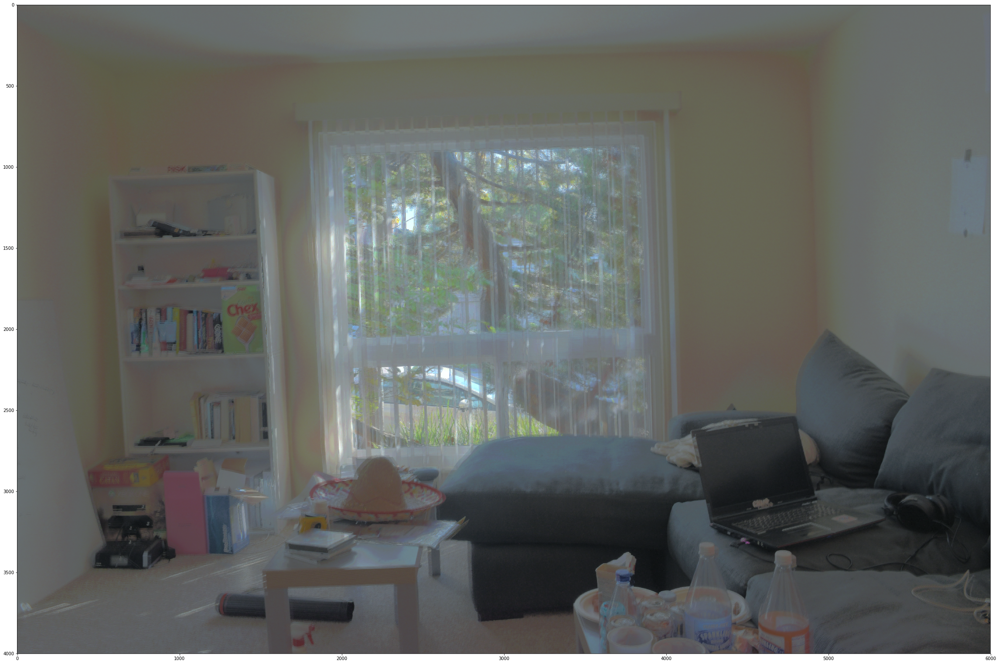

In [62]:
plt.figure(figsize=(40,60))
plt.imshow(tonemapped3)
plt.show()

In [69]:
imheight32,imwidth32 = data_b3[0][0].shape
hdr32 = np.zeros((imheight32,imwidth32,3) , 'float64')
hdr32[...,0]=ln_E_b3
hdr32[...,1]=ln_E_g3
hdr32[...,2]=ln_E_r3
tonemapped32 = tone_mapping_basic(np.log(hdr32))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


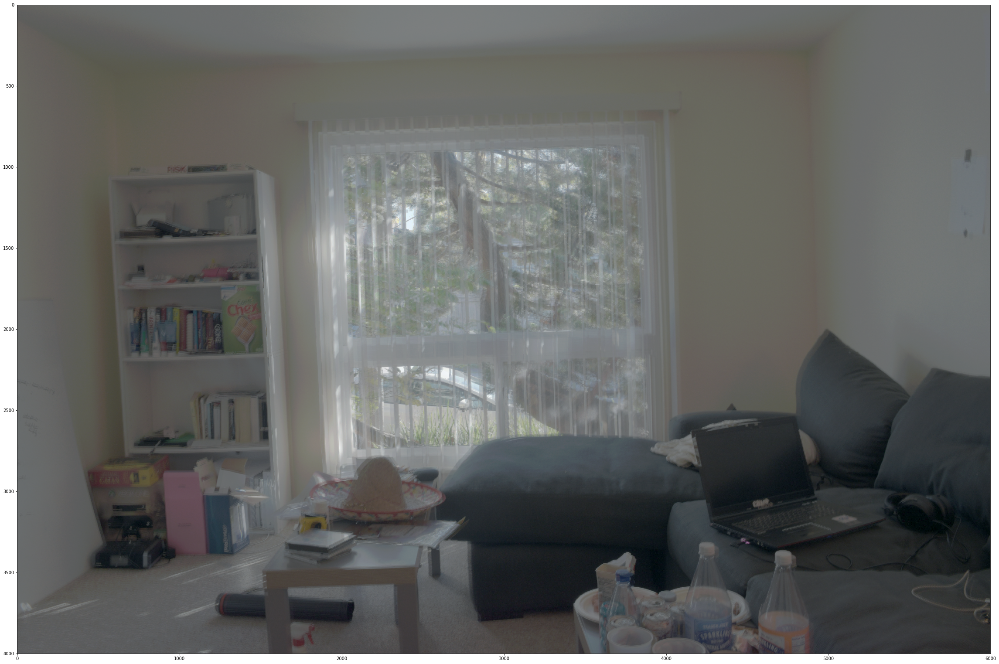

In [70]:
plt.figure(figsize=(40,60))
plt.imshow(tonemapped32)
plt.show()

In [ ]:
'''
data_b3 = get_images_and_exposure("2/",0,".PNG",4)
data_g3 = get_images_and_exposure("2/",1,".PNG",4)
data_r3 = get_images_and_exposure("2/",2,".PNG",4)
plt.imshow(data_b3[0][0])
print(data_b3)
variables_b3 = get_samples(data_b3,(20,20),20)
variables_g3 = get_samples(data_g3,(20,20),20)
variables_r3 = get_samples(data_r3,(20,20),20)
response_curve_b3 = get_response_curve(variables_b3[0],variables_b3[1],variables_b3[2],variables_b3[3])
response_curve_g3 = get_response_curve(variables_g3[0],variables_g3[1],variables_g3[2],variables_g3[3])
response_curve_r3 = get_response_curve(variables_r3[0],variables_r3[1],variables_r3[2],variables_r3[3])
plt.figure(figsize=(10,7))
plt.plot(response_curve_b3[0], range(256))
plt.plot(response_curve_g3[0], range(256))
plt.plot(response_curve_r3[0], range(256))
plt.show()
print(response_curve_b2[0].shape)
ln_E_b3 = get_radiance_map(data_b3[0],response_curve_b3[0],variables_b3[1],variables_b3[3])
ln_E_g3 = get_radiance_map(data_g3[0],response_curve_g3[0],variables_g3[1],variables_g3[3])
ln_E_r3 = get_radiance_map(data_r3[0],response_curve_r3[0],variables_r3[1],variables_r3[3])
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_r3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_b3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_g3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_r3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_b3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_g3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_r3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_b3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(np.log(ln_E_g3),cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_r3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_b3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(12,8))
plt.imshow(ln_E_g3,cmap='jet')
plt.colorbar()
plt.show()
plt.figure(figsize=(40,60))
plt.imshow(tonemapped3)
plt.show()
'''